In [1]:
"""
Class
- Normalize Data
- Harmonize Data
- Build Classifier
- Classify
- Split
- - Class
"""

'\nClass\n- Normalize Data\n- Harmonize Data\n- Build Classifier\n- Classify\n- Split\n- - Class\n'

In [2]:
# from fish_helpers import *
# import torch
# import scvi
# import scanpy as sc
# import anndata
# sc.set_figure_params(figsize=(7, 7))
import sys
sys.path.insert(0, '/home/fangming/projects/dredfish/packages/PySpots/')
sys.path.insert(0, '/home/fangming/projects/myutils/')

from fish_helpers import *
# import torch
# import scvi
import scanpy as sc
import anndata

import basicu
sc.set_figure_params(figsize=(7, 7))

In [3]:
ref_path = '/bigstore/binfo/mouse/Brain/DRedFISH/Allen_V3_Reference/10X_dpnmf/'
weights = pd.read_csv(os.path.join(ref_path,'weights.csv'),index_col=0)
# vizgen_distributions = pd.read_csv('/bigstore/binfo/mouse/Brain/FISH/Vizgen_data/cell_type_abundances_S2.csv',index_col=0)

In [4]:
""" Data """
""" Load Measured Data """
# data = anndata.read_h5ad('/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/results/clustered.h5ad')
measured_path = '/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/results'
# if os.path.exists(os.path.join(measured_path,'clustered.h5ad')):
measured_data = anndata.read_h5ad(os.path.join(measured_path,'clustered.h5ad'))
measured_data.obs_names_make_unique()
# else:
#     measured_counts = np.load(os.path.join(measured_path,'vectors.npy'),allow_pickle=True)
#     measured_cell_metadata = pd.read_csv(os.path.join(measured_path,'cell_metadata.csv'),low_memory=False,index_col=0)
#     measured_cells = np.array(measured_cell_metadata.index)
#     measured_genes = np.array(weights.columns)
#     measured_data = anndata.AnnData(X=measured_counts,var=pd.DataFrame(index=measured_genes),obs=pd.DataFrame(index=measured_cells))
#     for column in measured_cell_metadata.columns:
#         if measured_cell_metadata[column].dtype=='O':
#             measured_data.obsm[column] = np.array(measured_cell_metadata[column].astype(str))
#         else:
#             measured_data.obsm[column] = np.array(measured_cell_metadata[column])
#     measured_data.obs_names_make_unique()
#     measured_data.write(filename=os.path.join(measured_path,'anndata.h5ad'))
#     del measured_counts,measured_cells,measured_genes,measured_cell_metadata
    
    
""" Load SmartSeq Reference """
ref_SS_path = '/bigstore/binfo/mouse/Brain/DRedFISH/Allen_V3_Reference/SmartSeq_dpnmf/'
# if os.path.exists(os.path.join(ref_SS_path,'anndata.h5ad')):
ref_SS_data = anndata.read_h5ad(os.path.join(ref_SS_path,'anndata.h5ad'))
ref_SS_data.obs_names_make_unique()
# else:
#     ref_SS_counts = np.load(os.path.join(ref_SS_path,'projected.npy'),allow_pickle=True)
#     ref_SS_cell_metadata = pd.read_csv(os.path.join(ref_SS_path,'metadata.csv'),low_memory=False,index_col=0)
#     ref_SS_cells = np.array(ref_SS_cell_metadata.index)
#     ref_SS_genes = np.array(weights.columns)
#     ref_SS_data = anndata.AnnData(X=ref_SS_counts,var=pd.DataFrame(index=ref_SS_genes),obs=pd.DataFrame(index=ref_SS_cells))
#     for column in ref_SS_cell_metadata.columns:
#         if ref_SS_cell_metadata[column].dtype=='O':
#             ref_SS_data.obsm[column] = np.array(ref_SS_cell_metadata[column].astype(str))
#         else:
#             ref_SS_data.obsm[column] = np.array(ref_SS_cell_metadata[column])
#     ref_SS_data.obs_names_make_unique()
#     ref_SS_data.write(filename=os.path.join(ref_SS_path,'anndata.h5ad'))
#     del ref_SS_counts,ref_SS_genes,ref_SS_cells,ref_SS_cell_metadata

In [5]:
""" Toss Cells with no signal """
# measured_data = measured_data[measured_data.X.sum(1)>1]
print(measured_data.shape)

# remove bit 19 because of 0 IQR
selected_bits = np.array([i for i in np.arange(24) if i != 19])
measured_data = measured_data[:,selected_bits]
ref_SS_data = ref_SS_data[:,selected_bits]

# filter out cells with zero values throughout all bits
rawmat = np.clip(measured_data.layers['total_vectors'].copy(), 0, None)
bitssum = rawmat.sum(axis=1)
measured_data = measured_data[bitssum > 0]
print(measured_data.shape)
print(ref_SS_data.shape)

(97786, 24)
(97614, 23)
(74973, 23)


In [6]:
# """ Class Balance to Vizgen Distributions """
# total_cells = measured_data.shape[0]
# ref_SS_data_balanced_idx = []
# labels = ref_SS_data.obsm['Level_3_subclass_label'].astype(str)
# for label in vizgen_distributions.index:
#     idxes = np.where(labels==label)[0]
#     t_ncells = int(total_cells*vizgen_distributions.loc[label]['0'])
#     if idxes.shape[0]<t_ncells:
#         idxes = np.random.choice(idxes,t_ncells,replace=True)
#     else:
#         idxes = np.random.choice(idxes,t_ncells,replace=False)
#     ref_SS_data_balanced_idx.extend(list(idxes))
# ref_SS_data_balanced = ref_SS_data[ref_SS_data_balanced_idx,:]
# print(ref_SS_data_balanced.shape)

In [7]:

# normalization
rawmat = np.clip(measured_data.layers['total_vectors'].copy(), 0, None)
bitssum = rawmat.sum(axis=1)
rawmat = rawmat/bitssum.reshape(-1,1) #data_s.obs['total_signal'].values.reshape(-1,1)
# rawmat_p = IQR_normalize_matrix_bycol(rawmat) # warning of dividing by zero; caused by bit 19 # not used here but used in code

# store
measured_data.layers['DPNMF'] = rawmat # measured_data.layers['total_vectors'].copy()/ # *(np.array(measured_data.obs['total_signal'])/np.array(measured_data.obs['total_signal']).mean())[:,None]
# ref_SS_data_balanced.layers['DPNMF'] = ref_SS_data.X.copy() # _balanced.X.copy()
ref_SS_data.layers['DPNMF'] = ref_SS_data.X.copy()


In [8]:
(bitssum == 0).sum()


0

In [9]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

class RecursiveClassify(object):
    def __init__(self,data,ref_data,level,verbose=True):
        self.data = data
        self.ref_data = ref_data
        self.level = level
        self.verbose = verbose
        
    def run(self):
        self.normalizeData()
        self.harmonizeData()
        self.classifyData()
        self.splitData()
        
    def normalizeData(self):
        def normalize_vector(v):
            v = v.copy()
            v = v-np.percentile(v,50)
            v = v/(np.percentile(v,75)-np.percentile(v,25))
            return v
        data = np.array(self.data.layers['DPNMF'].copy())
        ref_data = np.array(self.ref_data.layers['DPNMF'].copy())
        for i in range(data.shape[1]):
            """ Scale bitwise first """
            data[:,i] = normalize_vector(data[:,i])
            ref_data[:,i] = normalize_vector(ref_data[:,i])
        self.data.layers['DPNMF_IQR'] = data.copy()
        self.ref_data.layers['DPNMF_IQR'] = ref_data.copy()
        
    def harmonizeData(self):
        merged_data = anndata.AnnData(X=np.concatenate([self.data.layers['DPNMF_IQR'].astype(float),self.ref_data.layers['DPNMF_IQR'].astype(float)]),
                                      var=np.array(self.data.var).astype(str),
                                      obs=np.concatenate([np.array(self.data.obs.index).astype(str),np.array(self.ref_data.obs.index).astype(str)]).astype(str))
        merged_data.obs['dataset'] = np.concatenate([np.array(['a' for i in range(len(self.data.obs))]),np.array(['b' for i in range(len(self.ref_data.obs))])]).astype(str)
        merged_data.obsm['DPNMF'] = merged_data.X.copy()
        merged_data.layers['DPNMF'] = merged_data.X.copy()
        merged_data.raw = merged_data

        import scanpy.external as sce
        # sce.pp.harmony_integrate(merged_data, 'dataset',basis='DPNMF',adjusted_basis='DPNMF_harmony')#,reference_values='b')
    
        # self.data.obsm['DPNMF_harmony'] = np.array(merged_data[merged_data.obs['dataset'] == 'a'].obsm['DPNMF_harmony'])
        # self.ref_data.obsm['DPNMF_harmony'] = np.array(merged_data[merged_data.obs['dataset'] == 'b'].obsm['DPNMF_harmony'])
        self.data.obsm['DPNMF_harmony'] = np.array(merged_data[merged_data.obs['dataset'] == 'a'].obsm['DPNMF'])
        self.ref_data.obsm['DPNMF_harmony'] = np.array(merged_data[merged_data.obs['dataset'] == 'b'].obsm['DPNMF'])
        
    def classBalance(self):
        """ Class Balance """
        n_cells = 100
        X = self.ref_data.obsm['DPNMF_harmony'].copy()
        Y = np.array(self.ref_data.obsm[self.level])
        Y_unique = np.unique(Y)
        X_balanced = []
        Y_balanced = []
        for y in Y_unique:
            idx = np.where(Y==y)[0]
            if idx.shape[0]>n_cells:
                idx = np.random.choice(idx,n_cells,replace=False)
            else:
                idx = np.random.choice(idx,n_cells,replace=True)
            X_balanced.append(X[idx,:])
            Y_balanced.append(Y[idx])
        self.X_balanced = np.concatenate(X_balanced)
        self.Y_balanced = np.concatenate(Y_balanced)
    
    def splitTestTrain(self):
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X_balanced, self.Y_balanced, test_size=0.4, random_state=42)
        
    def buildModel(self):
        self.method = 'KNeighborsClassifier'
        self.model =  KNeighborsClassifier(15,metric='correlation')
        
    def trainModel(self):
        self.model.fit(self.X_train,self.y_train)
        
    def predictLabels(self):
        self.data.obs[self.level+'_predicted'] = self.model.predict(self.data.obsm['DPNMF_harmony'].copy())
        
    def classifyData(self):
        self.classBalance()
        self.splitTestTrain()
        self.buildModel()
        self.trainModel()
        self.predictLabels()
        
    def splitData(self):
        levels = np.array([i for i in self.ref_data.obsm if i.split('_')[0]=='Level'])
        for level in levels:
            self.ref_data.obs[level] = np.array(self.ref_data.obsm[level])
        loc = np.where(levels==self.level)[0][0]+1
        if loc>=len(levels):
            """ No More Levels"""
        else:
            next_level = levels[loc]
            self.data.obs[next_level+'_predicted'] = np.array(['Unknown' for i in range(self.data.shape[0])])
            ref_data_labels = np.array(self.ref_data.obs[self.level])
            data_labels = np.array(self.data.obs[self.level+'_predicted'])
            unique_labels = np.unique(data_labels)
            if self.verbose:
                if self.level ==levels[0]:
                    level = self.level
                else:
                    previous_level = levels[loc-2]
                    level = self.level + '_' + str(np.unique(self.ref_data.obs[previous_level])[0])
                iterable = tqdm(unique_labels,desc=level)
            else:
                iterable = unique_labels
            for label in iterable:
                try:
                    self.rc = RecursiveClassify(self.data[data_labels==label].copy(),self.ref_data[ref_data_labels==label].copy(),next_level,verbose=self.verbose)
                    self.rc.run()
                except Exception as e:
                    print(e)
                    print(label+'_Failed')
                for level in levels:
                        if level+'_predicted' in self.rc.data.obs:
                            if not level+'_predicted' in self.data.obs:
                                self.data.obs[level+'_predicted'] = np.array(['Unknown' for i in range(self.data.shape[0])])
                            try:
                                temp = np.array(self.data.obs[level+'_predicted'])
                                temp[data_labels==label] = np.array(self.rc.data.obs[level+'_predicted'])
                                self.data.obs[level+'_predicted'] = temp
                            except:
                                print(level+'_predicted '+label)
                                continue

In [10]:
data = measured_data.copy()
ref_data  = ref_SS_data.copy()# _balanced.copy()
levels = [i for i in ref_data.obsm if i.split('_')[0]=='Level']           
rc = RecursiveClassify(data.copy(),ref_data.copy(),levels[0],verbose=True)
rc.run()    

Level_2_neighborhood_label_Astro/Olig:   0%|          | 0/1 [00:00<?, ?it/s]

Level_3_subclass_label_Other:   0%|          | 0/2 [00:00<?, ?it/s]


Level_4_supertype_label_Astro:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_Astro: 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]


Level_3_subclass_label_Other:  50%|█████     | 1/2 [00:00<00:00,  1.32it/s]


Level_4_supertype_label_Oligo:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_Oligo:  33%|███▎      | 1/3 [00:00<00:00,  9.85it/s]


Level_4_supertype_label_Oligo: 100%|██████████| 3/3 [00:00<00:00,  8.50it/s]


Level_3_subclass_label_Other: 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

Level_2_neighborhood_label_GABAergic:   0%|          | 0/3 [00:00<?, ?it/s]

Level_3_subclass_label_CGE:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_Lamp5:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_Lamp5:  33%|███▎      | 1/3 [00:00<00:00,  8.65it/s]


Level_4_supertype_label

Input contains NaN, infinity or a value too large for dtype('float32').
Arhgap6_Failed




Level_3_subclass_label_L2_3_IT:   0%|          | 0/7 [00:00<?, ?it/s]


Level_4_supertype_label_L2 IT ENTl: 100%|██████████| 1/1 [00:00<00:00, 10.62it/s]A


Level_3_subclass_label_L2_3_IT:  14%|█▍        | 1/7 [00:00<00:01,  4.88it/s]


Level_4_supertype_label_L2 IT RHP:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_L2 IT RHP: 100%|██████████| 3/3 [00:00<00:00, 11.80it/s]


Level_3_subclass_label_L2_3_IT:  29%|██▊       | 2/7 [00:00<00:01,  3.05it/s]


Level_4_supertype_label_L2/3 IT CTX-1:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_L2/3 IT CTX-1:  33%|███▎      | 1/3 [00:00<00:00,  7.77it/s]


Level_4_supertype_label_L2/3 IT CTX-1:  67%|██████▋   | 2/3 [00:00<00:00,  4.92it/s]


Level_4_supertype_label_L2/3 IT CTX-1: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s]


Level_3_subclass_label_L2_3_IT:  43%|████▎     | 3/7 [00:01<00:02,  1.86it/s]


Level_4_supertype_label_L2/3 IT CTX-2:   0%|          | 0/2 [00:00<?, ?it/s]


Level_4_supertype_label_

Input contains NaN, infinity or a value too large for dtype('float32').
Grik1_Failed
Input contains NaN, infinity or a value too large for dtype('float32').
Stard8_Failed





Level_4_supertype_label_L2/3 IT PPP:   0%|          | 0/4 [00:00<?, ?it/s]


Level_4_supertype_label_L2/3 IT PPP:  50%|█████     | 2/4 [00:00<00:00, 12.38it/s]


Level_4_supertype_label_L2/3 IT PPP: 100%|██████████| 4/4 [00:00<00:00, 12.45it/s]


Level_3_subclass_label_L2_3_IT:  86%|████████▌ | 6/7 [00:02<00:00,  2.04it/s]


Level_4_supertype_label_L3 IT ENT:   0%|          | 0/2 [00:00<?, ?it/s]


Level_4_supertype_label_L3 IT ENT: 100%|██████████| 2/2 [00:00<00:00, 10.21it/s]


Level_3_subclass_label_L2_3_IT: 100%|██████████| 7/7 [00:03<00:00,  2.23it/s]

Level_2_neighborhood_label_Glutamatergic:  33%|███▎      | 2/6 [00:06<00:13,  3.49s/it]

Level_3_subclass_label_L4_5_6_IT_Car3:   0%|          | 0/6 [00:00<?, ?it/s]


Level_4_supertype_label_Car3:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_Car3: 100%|██████████| 1/1 [00:00<00:00,  5.06it/s]


Level_3_subclass_label_L4_5_6_IT_Car3:  17%|█▋        | 1/6 [00:00<00:01,  2.54it/s]


Level_4_supertype_label_L4/5 I

Input contains NaN, infinity or a value too large for dtype('float32').
Slc22a4_Failed
Input contains NaN, infinity or a value too large for dtype('float32').
Tshz2_Failed





Level_4_supertype_label_L5 IT CTX:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_L5 IT CTX: 100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


Level_3_subclass_label_L4_5_6_IT_Car3:  50%|█████     | 3/6 [00:01<00:01,  2.02it/s]


Level_4_supertype_label_L5 IT TPE-ENT: 100%|██████████| 1/1 [00:00<00:00, 11.53it/s]A


Level_3_subclass_label_L4_5_6_IT_Car3:  67%|██████▋   | 4/6 [00:01<00:00,  2.56it/s]


Level_4_supertype_label_L6 IT CTX:   0%|          | 0/4 [00:00<?, ?it/s]


Level_4_supertype_label_L6 IT CTX:  50%|█████     | 2/4 [00:00<00:00, 13.62it/s]


Level_4_supertype_label_L6 IT CTX: 100%|██████████| 4/4 [00:00<00:00, 10.46it/s]


Level_3_subclass_label_L4_5_6_IT_Car3:  83%|████████▎ | 5/6 [00:02<00:00,  2.20it/s]


Level_4_supertype_label_L6 IT ENTl: 100%|██████████| 1/1 [00:00<00:00, 11.23it/s]A


Level_3_subclass_label_L4_5_6_IT_Car3: 100%|██████████| 6/6 [00:02<00:00,  2.39it/s]

Level_2_neighborhood_label_Glutamatergic:  50%|█████     | 3/6 [00:10<00:10,  

Input contains NaN, infinity or a value too large for dtype('float32').
V3d_Failed




Level_3_subclass_label_PT:   0%|          | 0/3 [00:00<?, ?it/s]


Level_4_supertype_label_L3 RSP-ACA:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_L3 RSP-ACA: 100%|██████████| 1/1 [00:00<00:00,  6.34it/s]


Level_3_subclass_label_PT:  33%|███▎      | 1/3 [00:00<00:00,  3.19it/s]


Level_4_supertype_label_L5 PPP:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_L5 PPP: 100%|██████████| 1/1 [00:00<00:00,  5.57it/s]


Level_3_subclass_label_PT:  67%|██████▋   | 2/3 [00:00<00:00,  2.82it/s]


Level_4_supertype_label_L5 PT CTX:   0%|          | 0/4 [00:00<?, ?it/s]


Level_4_supertype_label_L5 PT CTX:  50%|█████     | 2/4 [00:00<00:00,  9.63it/s]


Level_4_supertype_label_L5 PT CTX: 100%|██████████| 4/4 [00:00<00:00, 10.16it/s]


Level_3_subclass_label_PT: 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]

Level_2_neighborhood_label_Immune/Vascular:   0%|          | 0/1 [00:00<?, ?it/s]

Level_3_subclass_label_Other:   0%|          | 0/5 [00:00<?, ?it/s]/tmp

Input contains NaN, infinity or a value too large for dtype('float32').
Endo_Failed





Level_4_supertype_label_Micro-PVM:   0%|          | 0/2 [00:00<?, ?it/s]


Level_4_supertype_label_Micro-PVM:  50%|█████     | 1/2 [00:00<00:00,  3.31it/s]


Level_4_supertype_label_Micro-PVM: 100%|██████████| 2/2 [00:00<00:00,  3.71it/s]


Level_3_subclass_label_Other:  40%|████      | 2/5 [00:01<00:01,  1.52it/s]/tmp/ipykernel_3801655/60586256.py:23: RuntimeWarning: divide by zero encountered in true_divide
  v = v/(np.percentile(v,75)-np.percentile(v,25))
/tmp/ipykernel_3801655/60586256.py:23: RuntimeWarning: invalid value encountered in true_divide
  v = v/(np.percentile(v,75)-np.percentile(v,25))


Level_3_subclass_label_Other:  60%|██████    | 3/5 [00:01<00:00,  2.45it/s]

Input contains NaN, infinity or a value too large for dtype('float32').
Oligo_Failed





Level_4_supertype_label_SMC-Peri:   0%|          | 0/2 [00:00<?, ?it/s]


Level_4_supertype_label_SMC-Peri:  50%|█████     | 1/2 [00:00<00:00,  2.70it/s]


Level_4_supertype_label_SMC-Peri: 100%|██████████| 2/2 [00:00<00:00,  2.40it/s]


Level_3_subclass_label_Other:  80%|████████  | 4/5 [00:03<00:01,  1.05s/it]


Level_4_supertype_label_VLMC:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_VLMC: 100%|██████████| 1/1 [00:00<00:00,  2.42it/s]


Level_3_subclass_label_Other: 100%|██████████| 5/5 [00:04<00:00,  1.20it/s]

Level_2_neighborhood_label_nan:   0%|          | 0/1 [00:00<?, ?it/s]

Level_3_subclass_label_nan:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_nan:   0%|          | 0/1 [00:00<?, ?it/s]


Level_4_supertype_label_nan: 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]


Level_3_subclass_label_nan: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

Level_1_class_label: 100%|██████████| 5/5 [00:52<00:00, 10.54s/it]


In [11]:
rc.data

AnnData object with n_obs × n_vars = 97614 × 23
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'stage_x', 'stage_y', 'leiden', 'opt_types', 'Level_1_class_label_predicted', 'Level_2_neighborhood_label_predicted', 'Level_3_subclass_label_predicted', 'Level_4_supertype_label_predicted', 'Level_5_cluster_label_predicted'
    uns: 'leiden', 'neighbors'
    obsm: 'stage', 'DPNMF_harmony'
    layers: 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors', 'DPNMF', 'DPNMF_IQR'
    obsp: 'connectivities', 'distances'

/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_1_class_label_predicted' as categorical
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_2_neighborhood_label_predicted' as categorical
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Cate

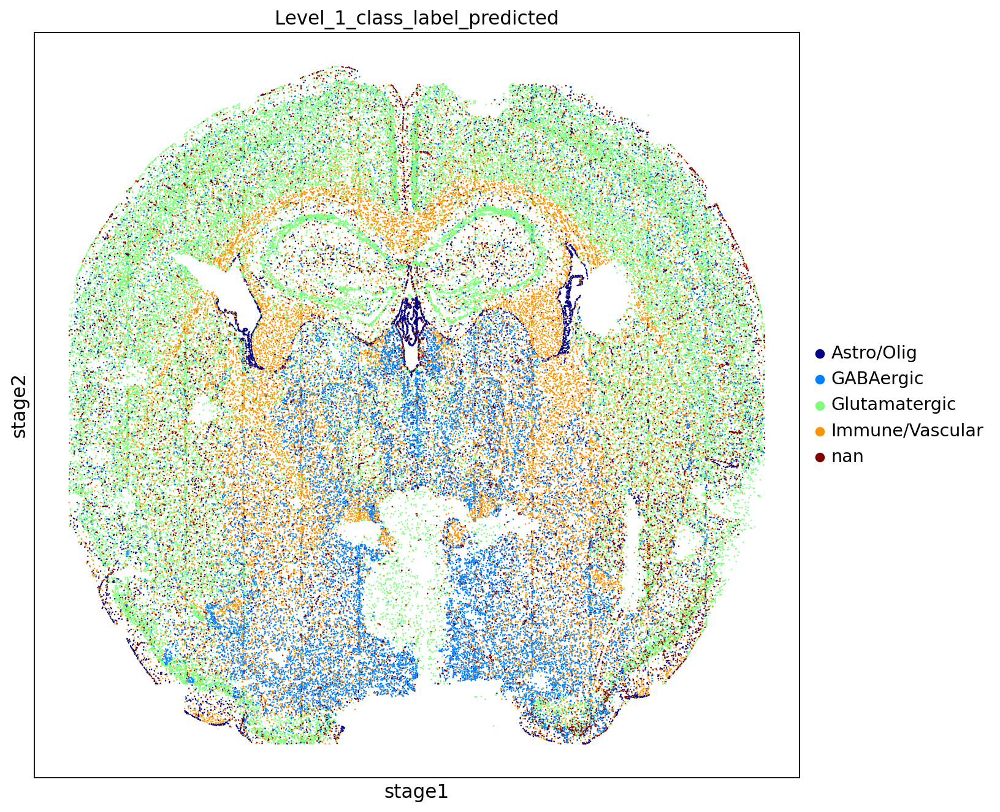

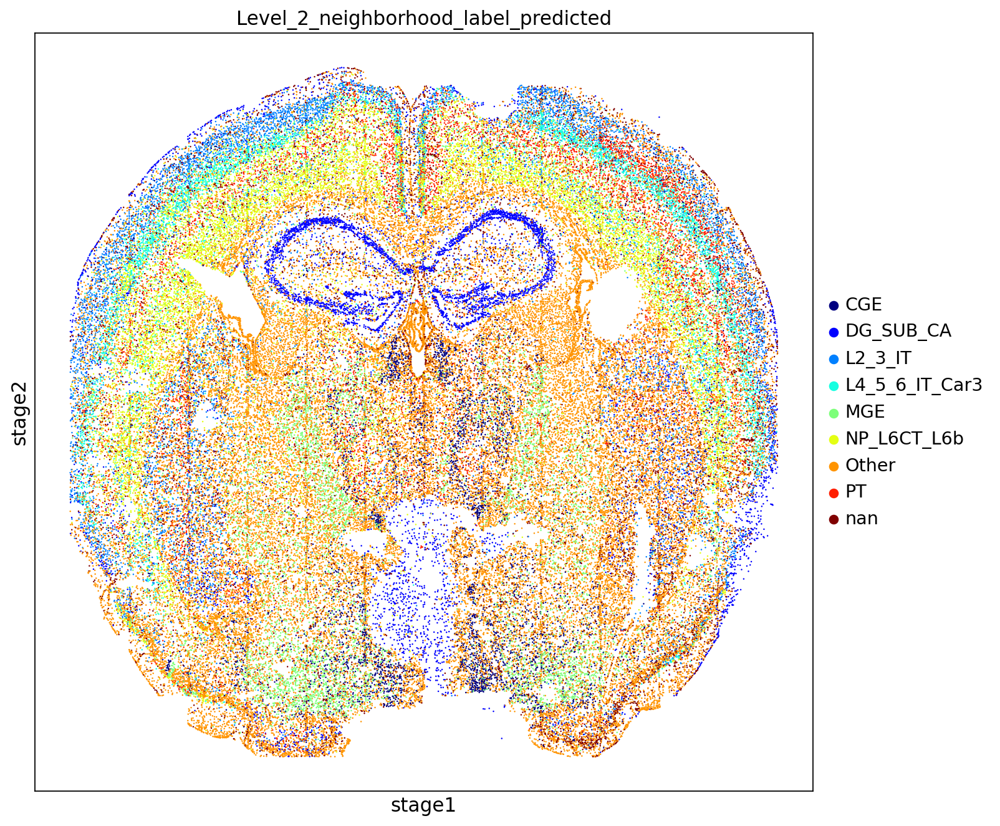

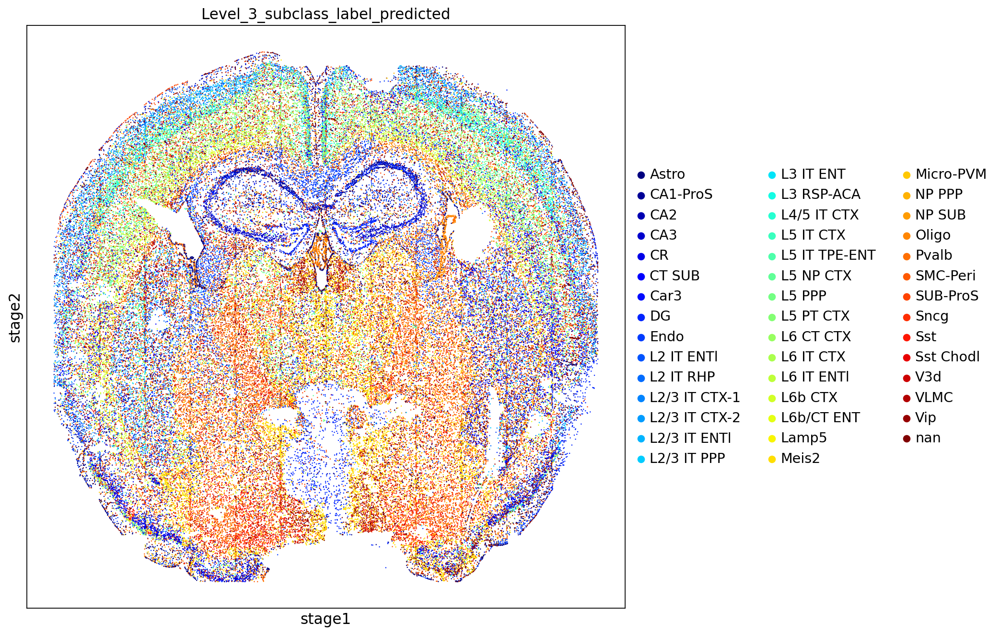

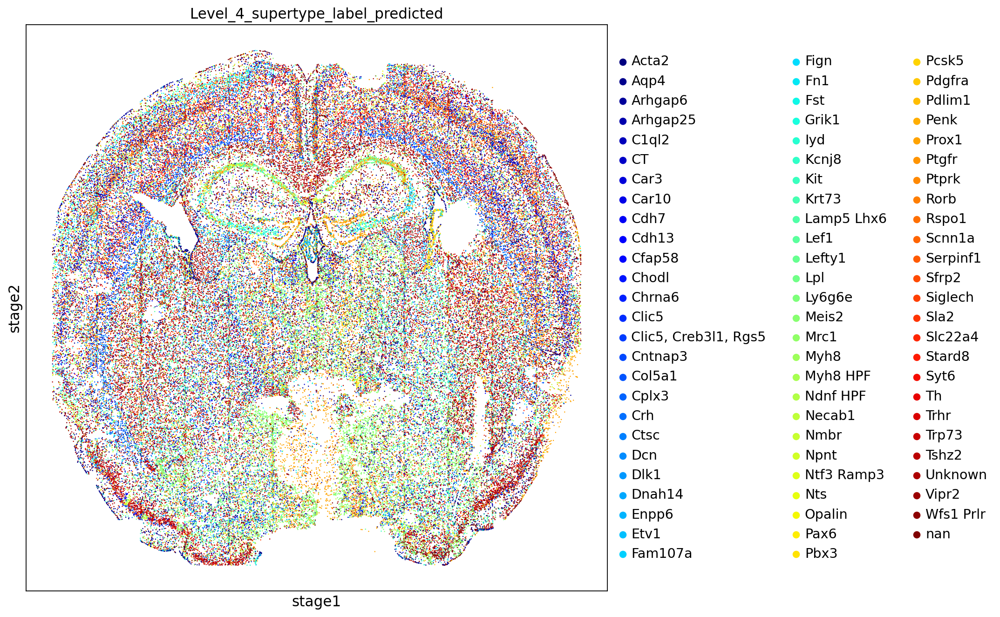

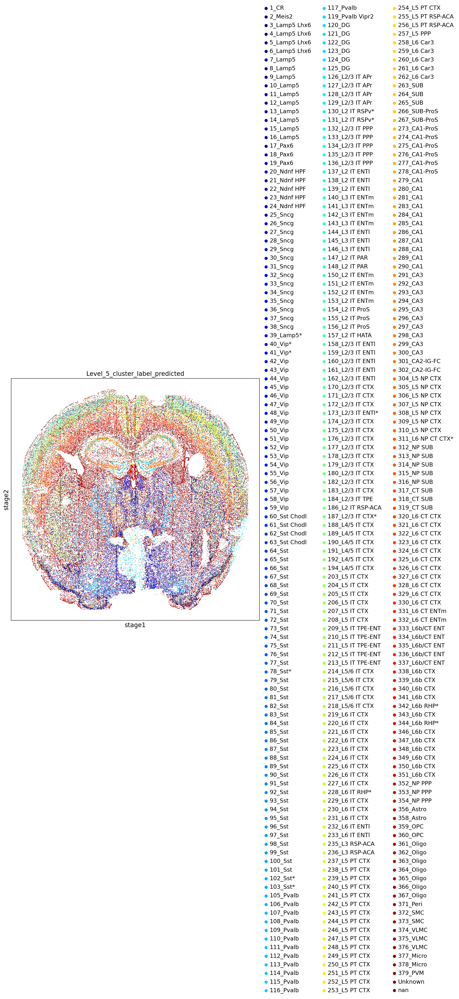

In [12]:
sc.set_figure_params(figsize=[10,10])
levels = [i for i in rc.data.obs if i.split('_')[0]=='Level']  
for level in levels:
    rc.data.obsm[level] = np.array(rc.data.obs[level])
    sc.pl.embedding(rc.data,'stage', color=[level],palette='jet',size=5)

In [13]:
data = rc.data

/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_1_class_label_predicted_updated' as categorical


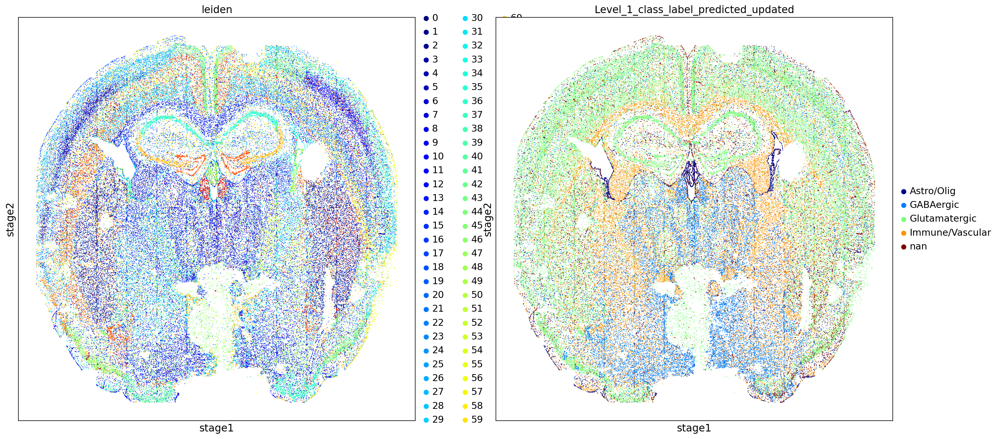

100%|██████████| 5/5 [00:02<00:00,  1.91it/s]
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_2_neighborhood_label_predicted_updated' as categorical


<Figure size 1200x1200 with 0 Axes>

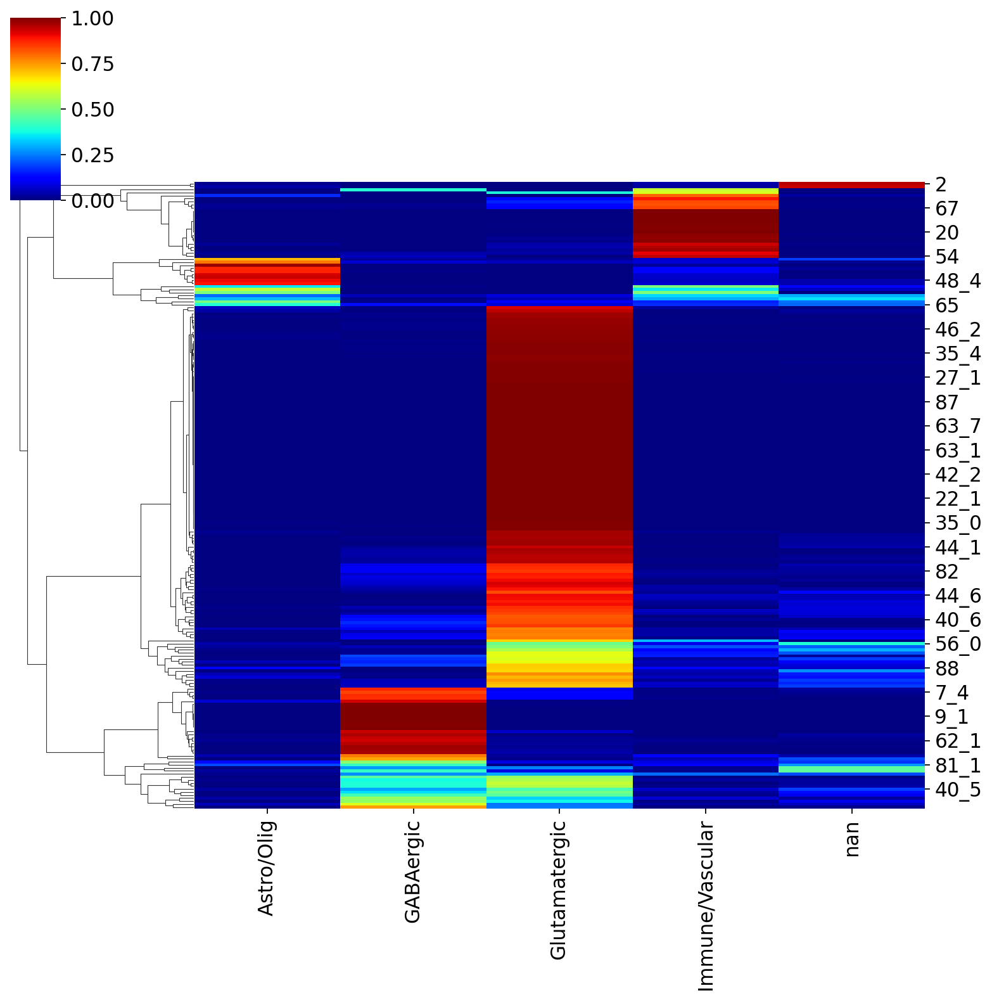

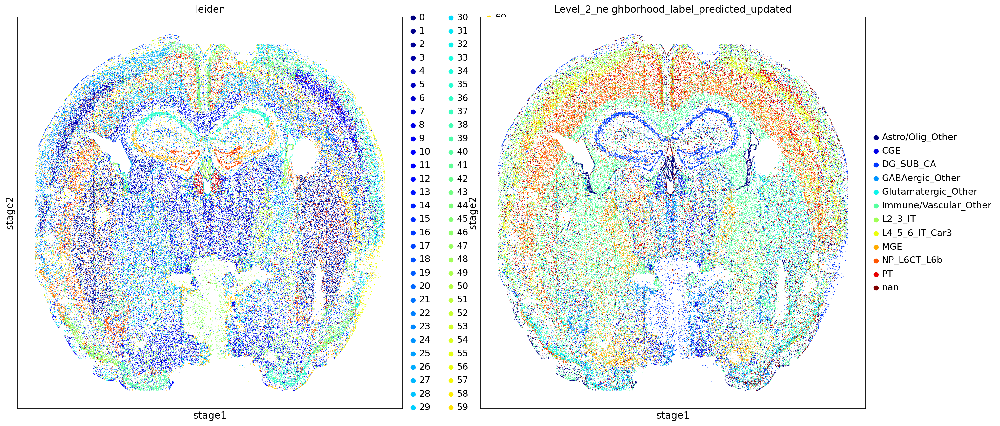

100%|██████████| 12/12 [00:06<00:00,  1.95it/s]
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_3_subclass_label_predicted_updated' as categorical


<Figure size 1200x1200 with 0 Axes>

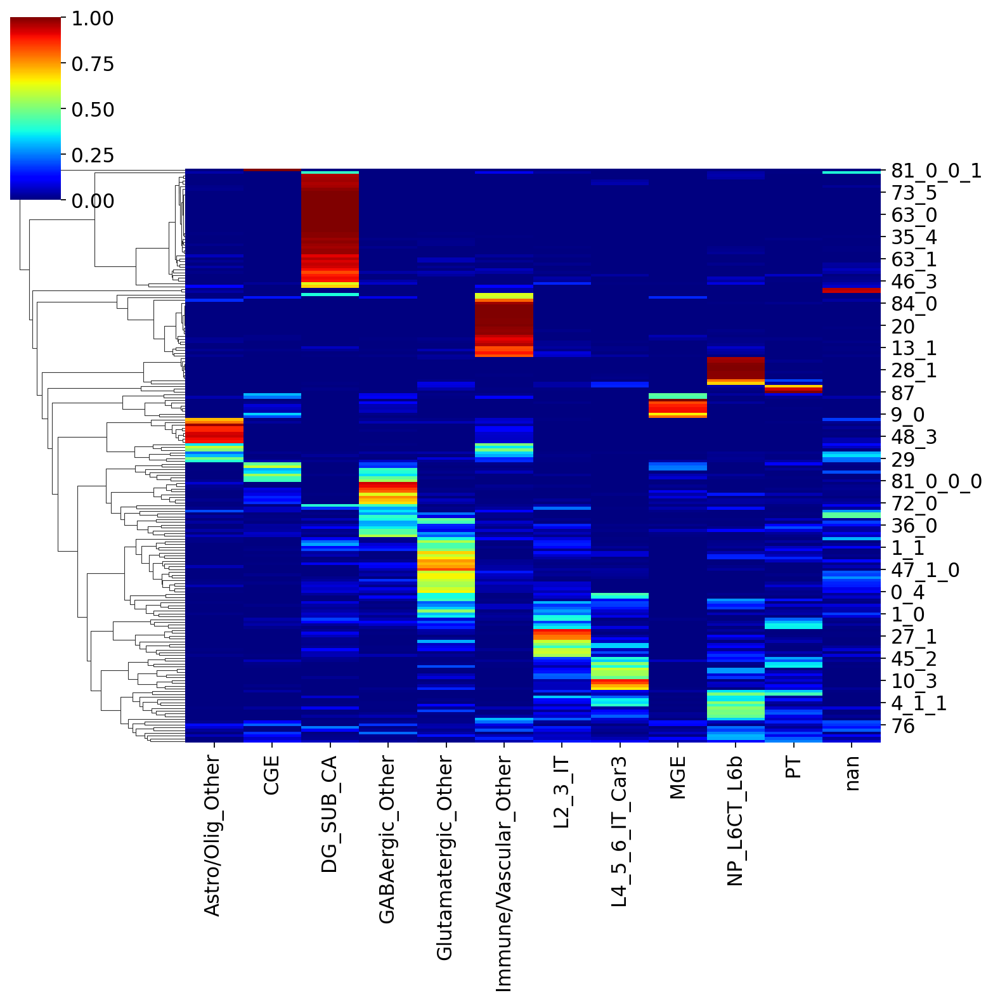

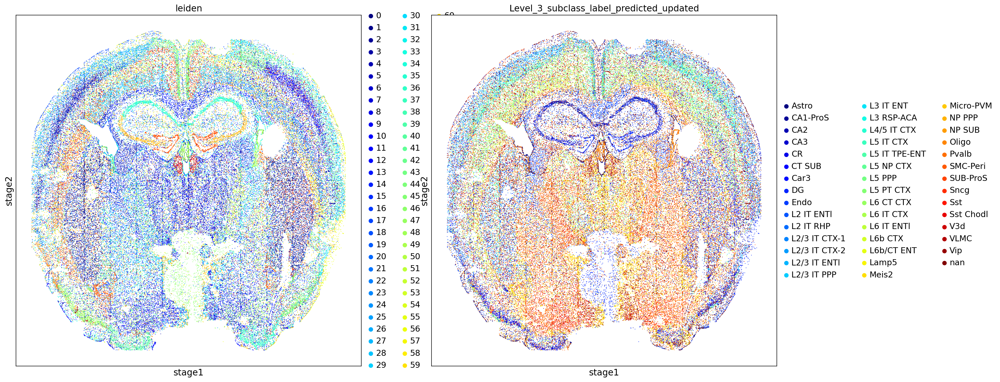

100%|██████████| 44/44 [00:21<00:00,  2.03it/s]
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_4_supertype_label_predicted_updated' as categorical


<Figure size 1200x1200 with 0 Axes>

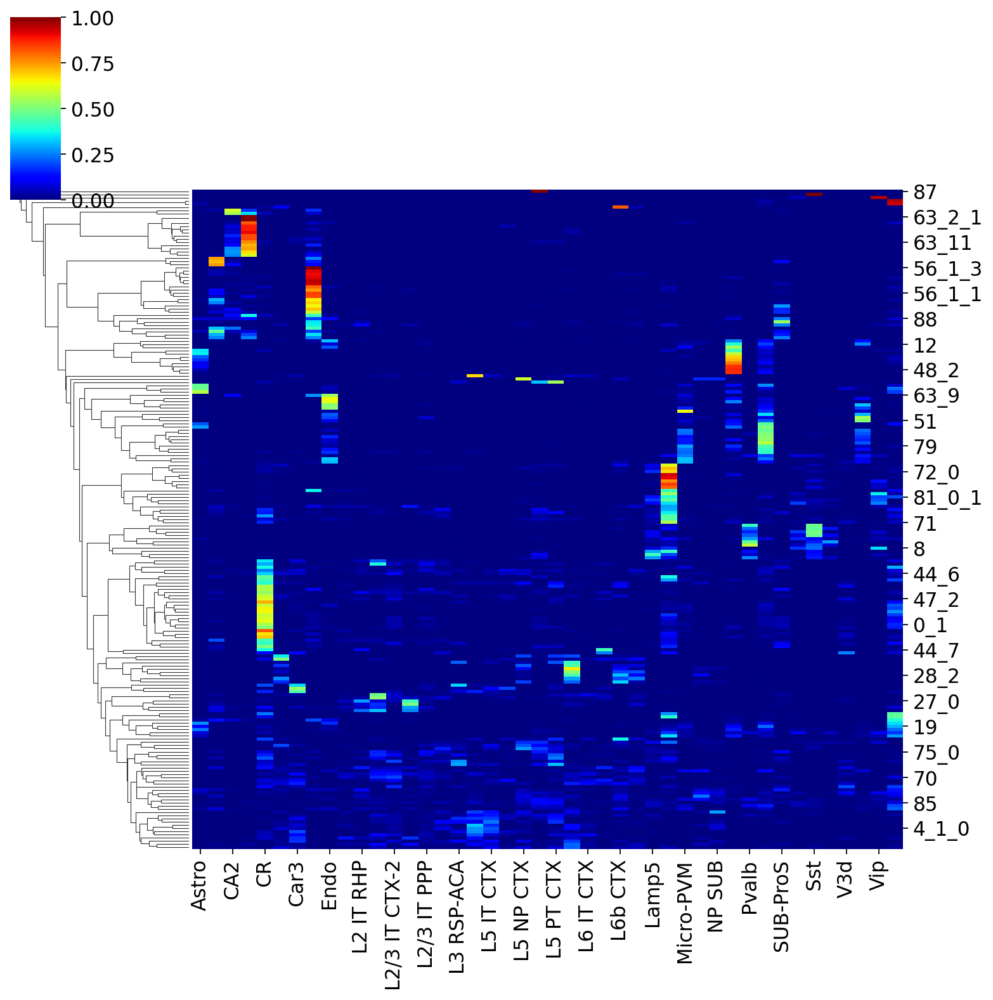

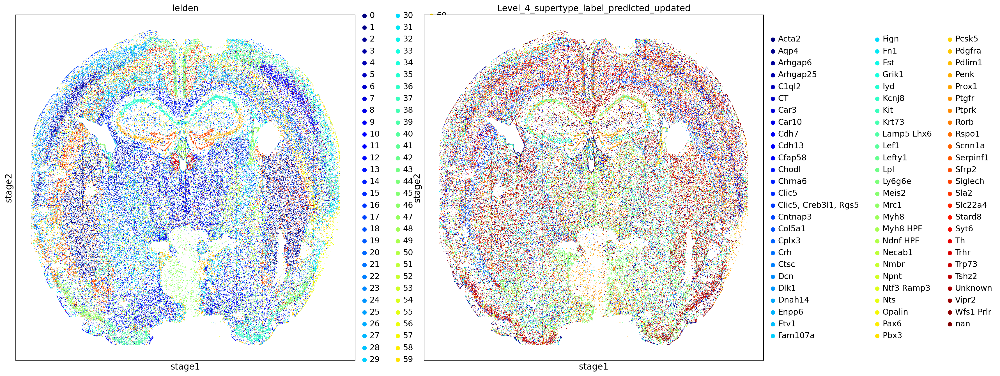

100%|██████████| 77/77 [00:36<00:00,  2.11it/s]
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/fangming/anaconda3/envs/routine/lib/python3.10/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Level_5_cluster_label_predicted_updated' as categorical


<Figure size 1200x1200 with 0 Axes>

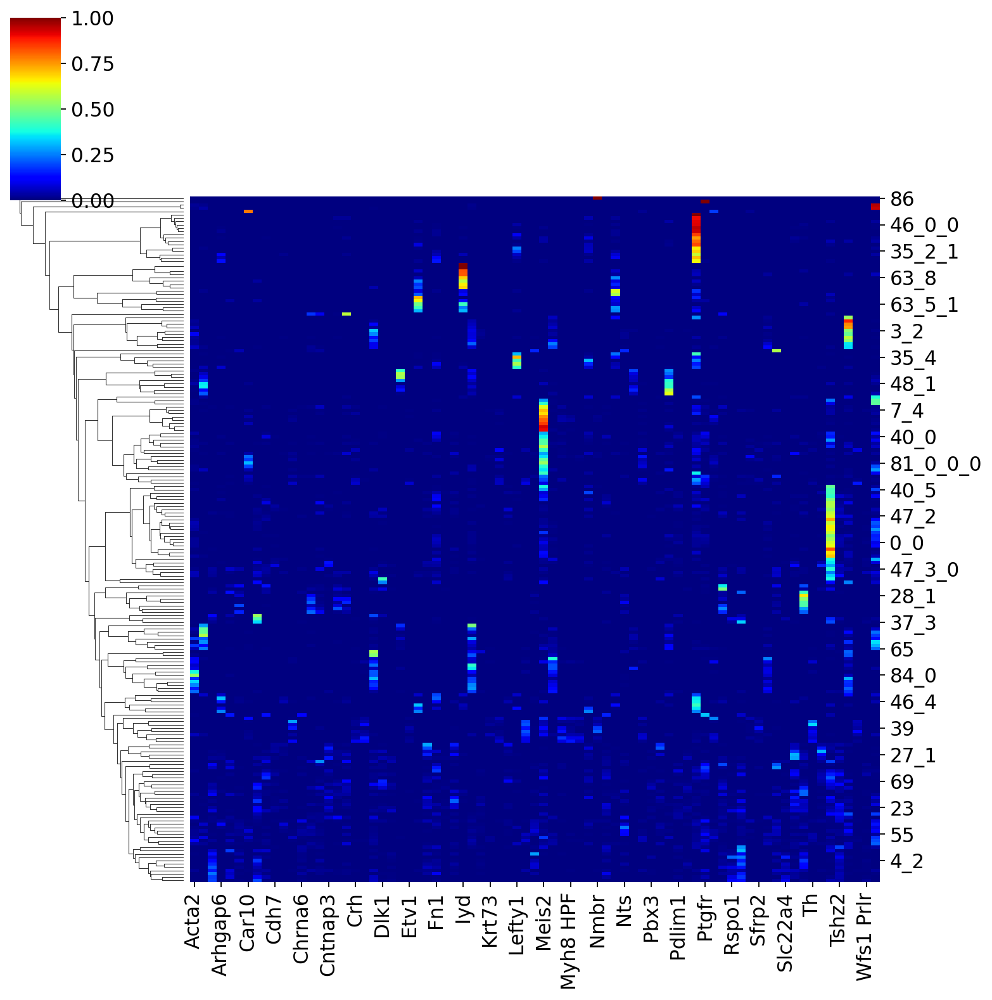

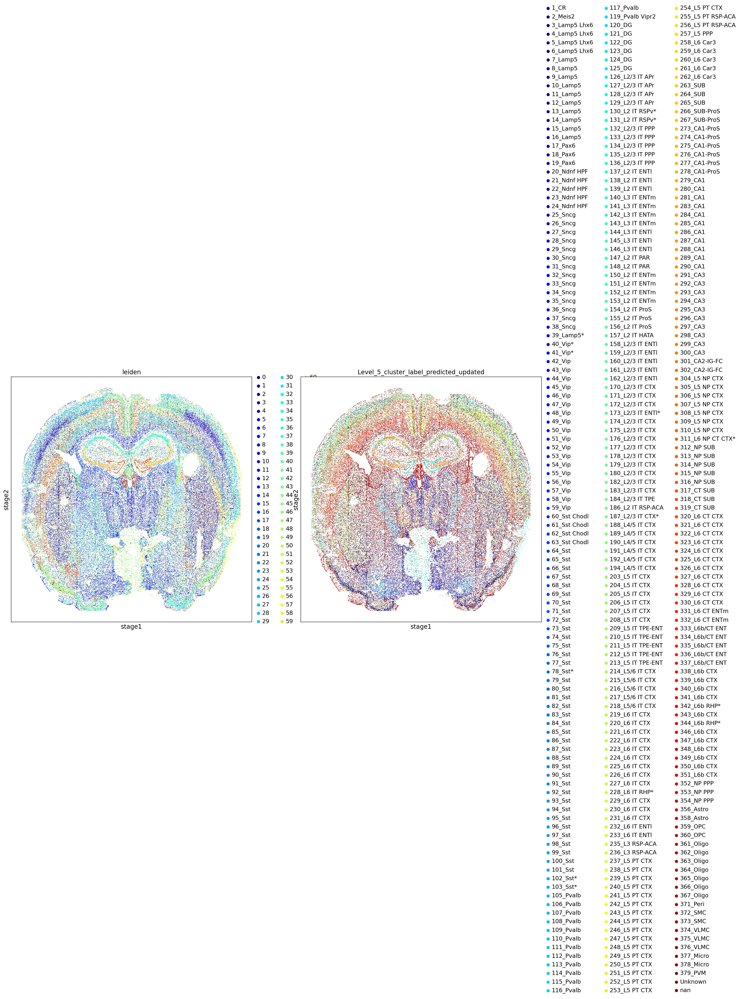

100%|██████████| 345/345 [02:43<00:00,  2.11it/s]


ValueError: invalid literal for int() with base 10: 'nan'

In [14]:
levels = np.array(levels)
for i,level in enumerate(levels):
    temp2 = np.array(data.obs[levels[i]])
    if 'Other' in np.unique(data.obs[level]):
        temp = np.array([i+'_Other' for i in data.obs[levels[i-1]]])
        temp2 = np.array(data.obs[levels[i]])
        temp2[temp2=='Other'] = temp[temp2=='Other']
    data.obs[levels[i]+'_updated'] = np.array(temp2)
    data.obsm[levels[i]+'_updated'] = np.array(data.obs[levels[i]+'_updated'])
    sc.pl.embedding(data,'stage', color=['leiden',levels[i]+'_updated'],palette='jet',size=4)
    
    data_labels = np.array(data.obs[levels[i]+'_updated'])
    ref_data_labels = np.array(data.obs['opt_types'])
    data_labels_unique = np.unique(data_labels)
    ref_data_labels_unique = np.unique(ref_data_labels)
    cmat = np.zeros([data_labels_unique.shape[0],ref_data_labels_unique.shape[0]])
    for i,i_label in tqdm(enumerate(data_labels_unique),total=data_labels_unique.shape[0]):
        i_mask =data_labels==i_label
        for j,j_label in enumerate(ref_data_labels_unique):
            j_mask = ref_data_labels==j_label
            cmat[i,j] = np.sum(i_mask&j_mask)
    cmat = cmat/cmat.sum(0)[:,None].T
    cmat = pd.DataFrame(cmat,index=data_labels_unique,columns=ref_data_labels_unique)
    idx_order = []
    for idx,i in enumerate(cmat.index):
        if 'Level_5' in level:
            if i=='Unknown':
                idx_order.append(0)
            else:
                idx_order.append(int(i.split('_')[0]))
        else:
            idx_order.append(idx)
    idx_order = np.array(cmat.index)[np.argsort(np.array(idx_order))]
    column_order = []
    for idx,i in enumerate(cmat.columns):
        N = 0
        for j,n in enumerate(i.split('_')):
            N+=(10**-j)*int(n)
        column_order.append(N)
    column_order = np.array(cmat.columns)[np.argsort(np.array(column_order))]
    cmat  = cmat[column_order].loc[idx_order]
    plt.figure(figsize=[15,15])
    p = sns.clustermap(cmat.T,cmap='jet',vmin=0,vmax=1,col_cluster=False)

In [15]:
measured_data

AnnData object with n_obs × n_vars = 97614 × 23
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'stage_x', 'stage_y', 'leiden', 'opt_types'
    uns: 'leiden', 'neighbors'
    obsm: 'stage'
    layers: 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors', 'DPNMF'
    obsp: 'connectivities', 'distances'

In [16]:
rc.data

AnnData object with n_obs × n_vars = 97614 × 23
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'stage_x', 'stage_y', 'leiden', 'opt_types', 'Level_1_class_label_predicted', 'Level_2_neighborhood_label_predicted', 'Level_3_subclass_label_predicted', 'Level_4_supertype_label_predicted', 'Level_5_cluster_label_predicted', 'Level_1_class_label_predicted_updated', 'Level_2_neighborhood_label_predicted_updated', 'Level_3_subclass_label_predicted_updated', 'Level_4_supertype_label_predicted_updated', 'Level_5_cluster_label_predicted_updated'
    uns: 'leiden', 'neighbors', 'Level_1_class_label_predicted_colors', 'Level_2_neighborhood_label_predicted_colors', 'Level_3_subclass_label_predicted_colors', 'Level_4_supertype_label_predicted_colors', 'Level_5_cluster_label_predicted_colors', 'leiden_colors', 'Level_1_class_label_predicted_updated_colors', 'Lev

In [17]:
for level in rc.data.obsm:
    if 'updated' in level:
        print(level.split('_updated')[0])
        measured_data.obs[level.split('_updated')[0]] = np.array(rc.data.obsm[level])
        measured_data.obsm[level.split('_updated')[0]] = np.array(rc.data.obsm[level])

Level_1_class_label_predicted
Level_2_neighborhood_label_predicted
Level_3_subclass_label_predicted
Level_4_supertype_label_predicted
Level_5_cluster_label_predicted


In [18]:
# measured_data.write(filename=os.path.join(measured_path,'labeled_renorm_noHarmony_March18.h5ad'))
# measured_data

measured_data.obs.to_csv(os.path.join(measured_path,'labeled_renorm_noHarmony_March18.csv'),
                         header=True, index=True
                        )